## Natural Language Tool kit

In [1]:
import nltk

    /Users/alfeng/nltk_data

### Stop words

In [47]:
sw = set(nltk.corpus.stopwords.words('english'))
print('stop words ',list(sw)[:7])

stop words  ["won't", "mightn't", 'weren', 'those', 't', "hasn't", 'very']


    # http://www.gutenberg.org/.   digital library , license expired .

In [48]:
gb = nltk.corpus.gutenberg

In [4]:
print("Gutenberg books ",gb.fileids()[-5:])

Gutenberg books  ['milton-paradise.txt', 'shakespeare-caesar.txt', 'shakespeare-hamlet.txt', 'shakespeare-macbeth.txt', 'whitman-leaves.txt']


In [5]:
text_send = gb.sents('milton-paradise.txt')[:2]

In [6]:
text_send

[['[', 'Paradise', 'Lost', 'by', 'John', 'Milton', '1667', ']'], ['Book', 'I']]

In [9]:
for sent in text_send:
    filtered = [ w for w in sent if w.lower() not in sw]
    print(filtered)
    tagged = nltk.pos_tag(filtered)
    print('Tagged ',tagged)
    words = []
    for word in tagged:
        if word[1] != 'NNP' and word[1] != 'CD':
            words.append(word[0])
    print(words)

['[', 'Paradise', 'Lost', 'John', 'Milton', '1667', ']']
Tagged  [('[', 'JJ'), ('Paradise', 'NNP'), ('Lost', 'NNP'), ('John', 'NNP'), ('Milton', 'NNP'), ('1667', 'CD'), (']', 'NN')]
['[', ']']
['Book']
Tagged  [('Book', 'NN')]
['Book']


### word counts    # bag_words

In [10]:
from sklearn.feature_extraction.text import CountVectorizer

In [11]:
hamlet = gb.raw('shakespeare-hamlet.txt')

In [12]:
macbeth = gb.raw('shakespeare-macbeth.txt')

In [13]:
cv = CountVectorizer(stop_words='english')

In [14]:
print('Fearture vector ',cv.fit_transform([hamlet,macbeth]).toarray())

Fearture vector  [[ 1  0  1 ... 14  0  1]
 [ 0  1  0 ...  1  1  0]]


In [15]:
feature_array = cv.fit_transform([hamlet,macbeth]).toarray()
feature_array

array([[ 1,  0,  1, ..., 14,  0,  1],
       [ 0,  1,  0, ...,  1,  1,  0]])

In [16]:
feature_array[0]

array([ 1,  0,  1, ..., 14,  0,  1])

In [17]:
cv

CountVectorizer(stop_words='english')

In [18]:
dir(cv)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_char_ngrams',
 '_char_wb_ngrams',
 '_check_n_features',
 '_check_stop_words_consistency',
 '_check_vocabulary',
 '_count_vocab',
 '_get_param_names',
 '_get_tags',
 '_limit_features',
 '_more_tags',
 '_repr_html_',
 '_repr_html_inner',
 '_repr_mimebundle_',
 '_sort_features',
 '_stop_words_id',
 '_validate_data',
 '_validate_params',
 '_validate_vocabulary',
 '_warn_for_unused_params',
 '_white_spaces',
 '_word_ngrams',
 'analyzer',
 'binary',
 'build_analyzer',
 'build_preprocessor',
 'build_tokenizer',
 'decode',
 'decode_error',
 'dtype',
 'encoding',
 'fit',
 'fit_transform',
 'fixe

### word frequency

In [44]:
import string

In [45]:
punctuation = set(string.punctuation)

In [46]:
punctuation

{'!',
 '"',
 '#',
 '$',
 '%',
 '&',
 "'",
 '(',
 ')',
 '*',
 '+',
 ',',
 '-',
 '.',
 '/',
 ':',
 ';',
 '<',
 '=',
 '>',
 '?',
 '@',
 '[',
 '\\',
 ']',
 '^',
 '_',
 '`',
 '{',
 '|',
 '}',
 '~'}

In [22]:
words = gb.words('shakespeare-caesar.txt')
sw = set(nltk.corpus.stopwords.words('english'))

In [23]:
filtered = [w.lower() for w in words if w.lower() not in sw and w.lower() not in punctuation]

In [24]:
fd = nltk.FreqDist(filtered)

In [25]:
print(fd.max())
fd['caesar']

caesar


190

In [26]:
    #fd.values()
    #fd.keys()

In [27]:
fd = nltk.FreqDist(nltk.bigrams(filtered))
fd

FreqDist({('let', 'vs'): 16, ('wee', 'l'): 15, ('mark', 'antony'): 13, ('st', 'thou'): 12, ('marke', 'antony'): 12, ('thou', 'art'): 11, ('lord', 'bru'): 11, ('would', 'haue'): 10, ('art', 'thou'): 9, ('brutus', 'cassius'): 9, ...})

In [28]:
fd.max()

('let', 'vs')

In [29]:
fd[fd.max()]

16

In [30]:
fd = nltk.FreqDist(nltk.trigrams(filtered))
fd

FreqDist({('enter', 'lucius', 'luc'): 4, ('wee', 'l', 'heare'): 4, ('beware', 'ides', 'march'): 3, ('ides', 'march', 'caes'): 3, ('mine', 'owne', 'part'): 3, ('thou', 'sleep', 'st'): 3, ('mark', 'antony', 'shall'): 3, ('thee', 'thou', 'st'): 3, ('hath', 'done', 'deed'): 3, ('let', 'vs', 'heare'): 3, ...})

In [31]:
fd.max()

('enter', 'lucius', 'luc')

In [32]:
fd[fd.max()]

4

### Naive Bayes Classifier

In [49]:
def word_features(word):
    return{'len':len(word)}


In [50]:
def isStopword(word):
    return word in sw or word in punctuation

In [51]:
labeled_words = ([(word.lower(),isStopword(word.lower())) for word in words])

In [52]:
import random
random.seed(42)
random.shuffle(labeled_words)

In [53]:
print(labeled_words[:5])

[('i', True), ('is', True), ('in', True), ('he', True), ('ambitious', False)]


In [54]:
featuresets = [(word_features(n),word) for (n,word) in labeled_words]

In [59]:
cutoff = int(.9*len(featuresets))
train_set, test_set = featuresets[:cutoff], featuresets[cutoff:]
classifier = nltk.NaiveBayesClassifier.train(train_set)

In [61]:
classifier.classify(word_features('the'))


True

In [62]:
featuresets

[({'len': 1}, True),
 ({'len': 2}, True),
 ({'len': 2}, True),
 ({'len': 2}, True),
 ({'len': 9}, False),
 ({'len': 1}, True),
 ({'len': 6}, False),
 ({'len': 4}, False),
 ({'len': 3}, True),
 ({'len': 2}, True),
 ({'len': 3}, True),
 ({'len': 3}, True),
 ({'len': 2}, True),
 ({'len': 6}, False),
 ({'len': 7}, False),
 ({'len': 1}, True),
 ({'len': 4}, True),
 ({'len': 4}, False),
 ({'len': 6}, False),
 ({'len': 2}, True),
 ({'len': 1}, True),
 ({'len': 3}, True),
 ({'len': 3}, True),
 ({'len': 4}, True),
 ({'len': 4}, False),
 ({'len': 1}, True),
 ({'len': 2}, True),
 ({'len': 4}, False),
 ({'len': 7}, False),
 ({'len': 4}, True),
 ({'len': 1}, True),
 ({'len': 6}, False),
 ({'len': 2}, True),
 ({'len': 3}, False),
 ({'len': 3}, True),
 ({'len': 4}, False),
 ({'len': 1}, True),
 ({'len': 3}, True),
 ({'len': 2}, True),
 ({'len': 3}, True),
 ({'len': 2}, True),
 ({'len': 6}, False),
 ({'len': 1}, True),
 ({'len': 2}, True),
 ({'len': 1}, True),
 ({'len': 4}, True),
 ({'len': 5}, False)

In [63]:
print("Accuracy ", nltk.classify.accuracy(classifier, test_set))

Accuracy  0.8521671826625387


In [64]:
classifier.show_most_informative_features(5)

Most Informative Features
                     len = 7               False : True   =     77.8 : 1.0
                     len = 6               False : True   =     52.2 : 1.0
                     len = 1                True : False  =     51.8 : 1.0
                     len = 2                True : False  =     10.9 : 1.0
                     len = 5               False : True   =     10.9 : 1.0


### Emotional analytics

In [230]:
import random
from nltk.corpus import movie_reviews

In [231]:
from nltk.corpus import stopwords

In [232]:
from nltk import FreqDist

In [233]:
from nltk import NaiveBayesClassifier

In [234]:
from nltk.classify import accuracy

In [235]:
import string

In [236]:
labeled_docs = [(list(movie_reviews.words(fid)),cat) for cat in movie_reviews.categories() for fid in movie_reviews.fileids(cat)]

In [237]:
random.seed(42)

In [238]:
review_words = movie_reviews.words()

In [239]:
review_words

['plot', ':', 'two', 'teen', 'couples', 'go', 'to', ...]

In [240]:
sw = set(stopwords.words('english'))

In [241]:
punctuation = set(string.punctuation)

In [242]:
def isStopWord(word):
    return word in sw or word in punctuation

In [243]:
filtered = [w.lower() for w in review_words if not isStopWord(w.lower())]

In [244]:
len(filtered)

710579

In [245]:
len(review_words)

1583820

In [246]:
words = FreqDist(filtered)

In [247]:
words

FreqDist({'film': 9517, 'one': 5852, 'movie': 5771, 'like': 3690, 'even': 2565, 'good': 2411, 'time': 2411, 'story': 2169, 'would': 2109, 'much': 2049, ...})

In [248]:
N = int(.05 * len(words.keys()))

In [249]:
N

1979

In [250]:
#since unique words could more than 10K , select only top 5% 
word_features = list(words.keys())[:N]
word_features

['plot',
 'two',
 'teen',
 'couples',
 'go',
 'church',
 'party',
 'drink',
 'drive',
 'get',
 'accident',
 'one',
 'guys',
 'dies',
 'girlfriend',
 'continues',
 'see',
 'life',
 'nightmares',
 'deal',
 'watch',
 'movie',
 'sorta',
 'find',
 'critique',
 'mind',
 'fuck',
 'generation',
 'touches',
 'cool',
 'idea',
 'presents',
 'bad',
 'package',
 'makes',
 'review',
 'even',
 'harder',
 'write',
 'since',
 'generally',
 'applaud',
 'films',
 'attempt',
 'break',
 'mold',
 'mess',
 'head',
 'lost',
 'highway',
 'memento',
 'good',
 'ways',
 'making',
 'types',
 'folks',
 'snag',
 'correctly',
 'seem',
 'taken',
 'pretty',
 'neat',
 'concept',
 'executed',
 'terribly',
 'problems',
 'well',
 'main',
 'problem',
 'simply',
 'jumbled',
 'starts',
 'normal',
 'downshifts',
 'fantasy',
 'world',
 'audience',
 'member',
 'going',
 'dreams',
 'characters',
 'coming',
 'back',
 'dead',
 'others',
 'look',
 'like',
 'strange',
 'apparitions',
 'disappearances',
 'looooot',
 'chase',
 'scenes'

In [251]:
len(word_features)

1979

In [252]:
def doc_features(doc):
    doc_words = FreqDist(w for w in doc if not isStopWord(w))
    features = {}
    for word in word_features:
        features['count (%s)'%word] =(doc_words.get(word,0))
    return features

In [253]:
featuresets = [(doc_features(d),c) for (d,c) in labled_docs]

In [254]:
featuresets

[({'count (plot)': 1,
   'count (two)': 2,
   'count (teen)': 4,
   'count (couples)': 1,
   'count (go)': 2,
   'count (church)': 1,
   'count (party)': 1,
   'count (drink)': 1,
   'count (drive)': 1,
   'count (get)': 3,
   'count (accident)': 1,
   'count (one)': 3,
   'count (guys)': 1,
   'count (dies)': 1,
   'count (girlfriend)': 1,
   'count (continues)': 1,
   'count (see)': 2,
   'count (life)': 1,
   'count (nightmares)': 1,
   'count (deal)': 1,
   'count (watch)': 1,
   'count (movie)': 6,
   'count (sorta)': 1,
   'count (find)': 1,
   'count (critique)': 1,
   'count (mind)': 3,
   'count (fuck)': 2,
   'count (generation)': 1,
   'count (touches)': 1,
   'count (cool)': 2,
   'count (idea)': 2,
   'count (presents)': 1,
   'count (bad)': 2,
   'count (package)': 1,
   'count (makes)': 1,
   'count (review)': 1,
   'count (even)': 3,
   'count (harder)': 1,
   'count (write)': 1,
   'count (since)': 2,
   'count (generally)': 1,
   'count (applaud)': 1,
   'count (films

In [255]:
train_set,test_set = featuresets[200:], featuresets[:200]

In [256]:
classifier = NaiveBayesClassifier.train(train_set)

In [257]:
print('Accuracy ',accuracy(classifier,test_set))

Accuracy  0.82


In [258]:
print(classifier.show_most_informative_features())

Most Informative Features
          count (stupid) = 2                 neg : pos    =     13.2 : 1.0
             count (bad) = 5                 neg : pos    =     12.9 : 1.0
          count (boring) = 2                 neg : pos    =     11.2 : 1.0
             count (bad) = 6                 neg : pos    =      9.6 : 1.0
        count (previous) = 2                 pos : neg    =      8.3 : 1.0
            count (crap) = 2                 neg : pos    =      7.9 : 1.0
       count (atrocious) = 1                 neg : pos    =      7.2 : 1.0
      count (apparently) = 2                 neg : pos    =      7.2 : 1.0
      count (recognizes) = 1                 pos : neg    =      7.2 : 1.0
   count (unimaginative) = 1                 neg : pos    =      7.1 : 1.0
None


In [259]:
N = int(0.1*len(words.keys()))

In [260]:
N

3958

In [261]:
tags = list(words.keys())[:N]

In [262]:
words_dl = {}
for tag in tags:
    #print(tag+':'+str(words[tag]))
    words_dl[tag]=words[tag]

In [263]:
ordered_words_dl = sorted(words_dl.items(), key=lambda x: x[1])

In [264]:
ordered_words_dl[-5:]

[('even', 2565),
 ('like', 3690),
 ('movie', 5771),
 ('one', 5852),
 ('film', 9517)]

### Advanced Filter and vectoered metric

In [265]:
from nltk.corpus import movie_reviews
from nltk.corpus import stopwords
from nltk.corpus import names
from nltk import FreqDist
from sklearn.feature_extraction.text import TfidfVectorizer
import itertools
import pandas as pd
import numpy as np
import string

In [266]:
sw = set(stopwords.words('english'))

In [274]:
punctuation = set(string.punctuation)

In [275]:
all_names = set([name.lower() for name in names.words()])

In [276]:
def isStopWord(word):
    return (word in sw or word in punctuation) or not word.isalpha() or word in all_names

In [277]:
review_words = movie_reviews.words()

In [278]:
filtered = [w.lower() for w in review_words if not isStopWord(w.lower())]

In [279]:
len(filtered)

642936

In [280]:
len(review_words)

1583820

In [281]:
words = FreqDist(filtered)

In [282]:
texts = []

In [283]:
for fid in movie_reviews.fileids():
    texts.append(" ".join([w.lower() for w in movie_reviews.words(fid) if not isStopWord(w.lower()) and words[w.lower()]>1]))

In [284]:
vectorizer = TfidfVectorizer(stop_words='english')

In [285]:
matrix = vectorizer.fit_transform(texts)

In [286]:
sums = np.array(matrix.sum(axis=0)).ravel()

In [288]:
ranks = []
for word, val in itertools.zip_longest(vectorizer.get_feature_names(), sums):
    ranks.append((word,val))

In [293]:
df = pd.DataFrame(ranks, columns = ["term", "tfidf"])
df

,term,tfidf
0,aa,0.186930
1,aaa,0.175894
2,aaaaaaaaah,0.177378
3,aaliyah,0.208709
4,aalyah,0.241624
...,...,...
23062,zuko,0.276890
23063,zundel,0.168795
23064,zwick,1.155728
23065,zwigoff,0.147634


In [297]:
df = df.sort_values(by =['tfidf'])
print(df.head())

                 term    tfidf
19963  superintendent  0.03035
8736            greys  0.03035
14010           ology  0.03035
2406          briefer  0.03035
2791      cannibalize  0.03035


In [298]:
N = int(.01 * len(df))

In [299]:
df = df.tail(N)

In [300]:
for term, tfidf in itertools.zip_longest(df["term"].values, df["tfidf"].values):
    print(term, ":", tfidf)

matter : 10.160156320157853
review : 10.162109208095815
seeing : 10.193962242951153
jokes : 10.195055387739588
past : 10.229789978743266
romantic : 10.270767948140588
directed : 10.27679275085064
start : 10.302358509215921
finally : 10.315385095902199
video : 10.356897657857315
despite : 10.36356758711268
ship : 10.370281211670585
beautiful : 10.415601266078719
scream : 10.421970655899635
sequence : 10.461140540373234
supposed : 10.473608248283002
shot : 10.497822532176006
face : 10.520647846526677
turn : 10.535466043788666
lives : 10.536265259335323
later : 10.536596993112912
tell : 10.54178804022045
camera : 10.580870634146848
works : 10.585001927065935
children : 10.59229934724306
live : 10.658879764040353
daughter : 10.685408819519905
earth : 10.6855987888017
mr : 10.711280266859085
car : 10.715492238654587
believe : 10.724994487616465
maybe : 10.738295943695265
person : 10.766043701757003
book : 10.799070874951035
worst : 10.801808893863994
hand : 10.815936702218032
named : 10.818

## Social Network Analysis

In [303]:
import networkx as nx

In [304]:
print([s for s in dir(nx) if s.endswith('graph')])

['LCF_graph', 'LFR_benchmark_graph', 'adjacency_graph', 'barabasi_albert_graph', 'barbell_graph', 'binomial_graph', 'bull_graph', 'caveman_graph', 'chordal_cycle_graph', 'chvatal_graph', 'circulant_graph', 'circular_ladder_graph', 'complete_bipartite_graph', 'complete_graph', 'complete_multipartite_graph', 'complete_to_chordal_graph', 'connected_caveman_graph', 'connected_watts_strogatz_graph', 'cubical_graph', 'cycle_graph', 'cytoscape_graph', 'davis_southern_women_graph', 'dense_gnm_random_graph', 'desargues_graph', 'diamond_graph', 'digraph', 'directed_havel_hakimi_graph', 'directed_joint_degree_graph', 'dodecahedral_graph', 'dorogovtsev_goltsev_mendes_graph', 'dual_barabasi_albert_graph', 'duplication_divergence_graph', 'edge_subgraph', 'ego_graph', 'empty_graph', 'erdos_renyi_graph', 'expected_degree_graph', 'extended_barabasi_albert_graph', 'fast_gnp_random_graph', 'florentine_families_graph', 'frucht_graph', 'gaussian_random_partition_graph', 'general_random_intersection_graph',

In [310]:
G = nx.davis_southern_women_graph()

In [311]:
import matplotlib.pyplot as plt

In [312]:
plt.figure(1)

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

(array([[2., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [2., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [2., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [1., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 2., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 2., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 1., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 2., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 1., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 2., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 2., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 2., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 2., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 2., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0., 0., 0.],


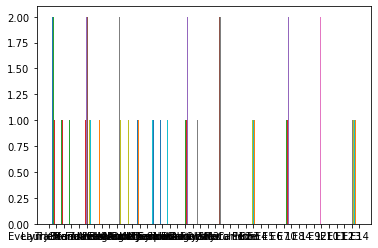

In [322]:
plt.hist(nx.degree(G))

In [325]:
plt.figure(2)


<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

In [326]:
pos = nx.spring_layout(G)

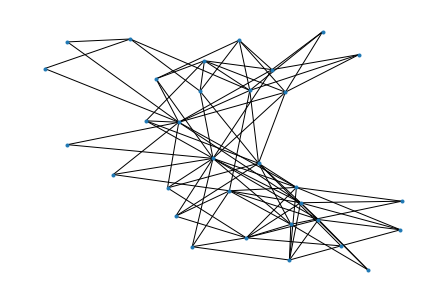

In [332]:
nx.draw(G,node_size=9)

{'Evelyn Jefferson': Text(0.04811624227766607, 0.4808841505701131, 'Evelyn Jefferson'),
 'Laura Mandeville': Text(-0.07843707281039249, 0.581123682136646, 'Laura Mandeville'),
 'Theresa Anderson': Text(0.13678219311965742, 0.3821056673953791, 'Theresa Anderson'),
 'Brenda Rogers': Text(0.13476020019172383, 0.5993257030343987, 'Brenda Rogers'),
 'Charlotte McDowd': Text(0.3425013475887902, 0.8072900333036481, 'Charlotte McDowd'),
 'Frances Anderson': Text(-0.2007653729568417, 0.49969531982872484, 'Frances Anderson'),
 'Eleanor Nye': Text(0.37651544215039534, 0.2816501315459252, 'Eleanor Nye'),
 'Pearl Oglethorpe': Text(0.33500311123128856, -0.0861986987315693, 'Pearl Oglethorpe'),
 'Ruth DeSand': Text(0.4296818498663717, 0.09059332974274914, 'Ruth DeSand'),
 'Verne Sanderson': Text(0.20399765984492652, -0.37095260127017377, 'Verne Sanderson'),
 'Myra Liddel': Text(-0.014436790992288303, -0.592772064940511, 'Myra Liddel'),
 'Katherina Rogers': Text(-0.446115501233377, -0.4015980871062988

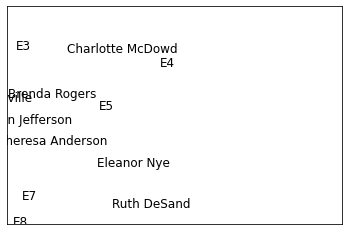

In [333]:
nx.draw_networkx_labels(G,pos)

In [334]:
plt.show()